In [110]:
from numpy.random import seed
from numpy.random import normal
from scipy import stats
from scipy.stats import chisquare
from scipy.stats import levene
import numpy as np
import decimal
from decimal import Decimal

from datetime import datetime
import math

def now():
    now = datetime.now()
    current_time = now.strftime("%H:%M:%S")
    print(" \n Current Time =", current_time)
    #return now

now()

 
 Current Time = 16:49:42


In [2]:
from numpy.random import seed
from numpy.random import normal

#make this example reproducible
seed(1)

#generate sample of 200 values that follow a normal distribution 
data = normal(loc=0, scale=1, size=200)

#view first six values
data[0:5]

#array([ 1.62434536, -0.61175641, -0.52817175, -1.07296862,  0.86540763])

array([ 1.62434536, -0.61175641, -0.52817175, -1.07296862,  0.86540763])

In [3]:
from numpy.random import seed
from numpy.random import normal

#make this example reproducible
seed(1)

#generate sample of 200 values that follow a normal distribution 
data = normal(loc=2, scale=0.5)

#view first six values
#data[0:5]
data

#array([ 1.62434536, -0.61175641, -0.52817175, -1.07296862,  0.86540763])

2.812172681831621

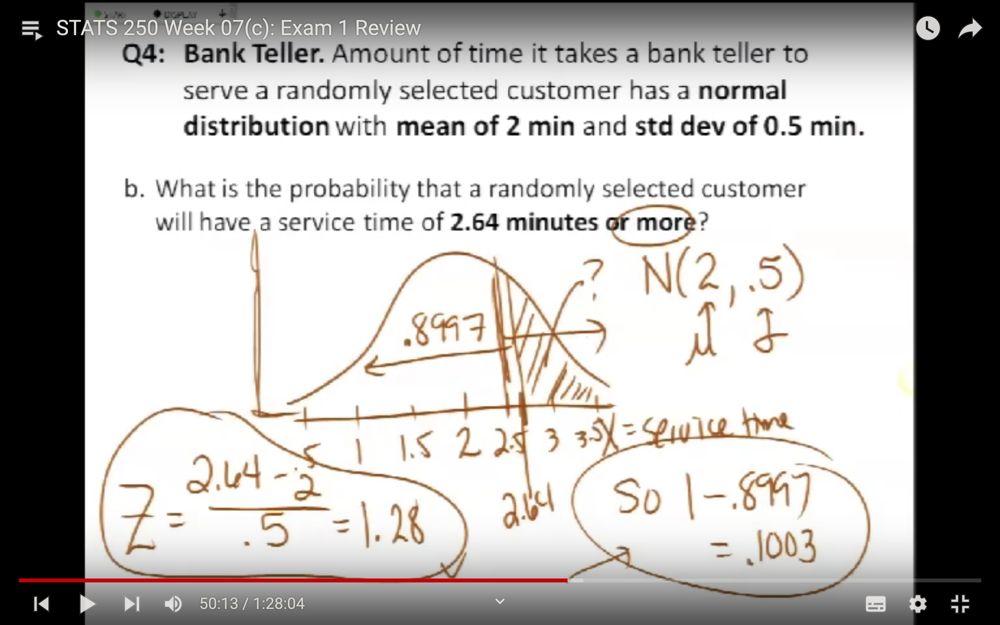

In [4]:
def z_score_finder(mean, std, target):
    z = (target-mean)/std
    p = stats.norm.cdf(z)
    print("Z is " +str(z))
    print("p is " +str(p))

    
z_score_finder(2, 0.5, 2.64)


now()    

Z is 1.2800000000000002
p is 0.8997274320455579
 
 Current Time = 13:15:38


In [5]:
#Use this to find the z and p of a left tailed test
def z_score_finder_r(mean, std, target):
    z = (target-mean)/std
    p = stats.norm.cdf(z)
    print("Z is " +str(z))
    print("p is " +str(p))
    return z, p

    
z, p = z_score_finder_r(2, 0.5, 2.64)

print("p-1= " + str(1-p))

now()    

Z is 1.2800000000000002
p is 0.8997274320455579
p-1= 0.10027256795444206
 
 Current Time = 13:15:38


In [137]:
z, p = z_score_finder_r(119, 22, 182)

Z is 2.8636363636363638
p is 0.9979059574932078


In [6]:
#Use this to find the t and p of a left tailed test
def t_score_finder_r(mean, std, target, n):
    dof = n -1
    sex = std/(math.sqrt(n))
    t = (target-mean)/sex
    p = stats.t.cdf(t, dof)
    print("T is " +str(z))
    print("p is " +str(p))
    return t, p

    
t, p = t_score_finder_r(40, 4, 39.1, 100)


now()    

T is 1.2800000000000002
p is 0.013331186128795162
 
 Current Time = 13:15:38


In [51]:
t, p = t_score_finder_r(863, 9, 860, 64)

print(1-p)

T is 2.8763665675384966
p is 0.004861784663202418
0.9951382153367976


In [7]:
#USe this to find the t score for the difference in 2 sample means
def pop_2_mean_pooled_t(mean1, mean2, s1, s2, n1, n2):
    dof = (n1+n2)-2
    mean_diff = mean1 - mean2
    #The N part on the right
    right_n = math.sqrt((1/n1) + (1/n2))
    #The Sp part
    sp_numereator_left = ((n1-1)*(s1**2))
    sp_numberator_right = ((n2-1)*(s2**2))
    sp = math.sqrt((sp_numereator_left + sp_numberator_right)/(dof))
    pooled_sp = sp*right_n
    t = mean_diff/pooled_sp
    p = stats.t.cdf(t, dof)
    print("T is " +str(t))
    print("p is " +str(p))
    return t, p


pop_2_mean_pooled_t(65.2, 70.3, 7.8, 8.4, 30, 30)

T is -2.4368742610942298
p is 0.00895208222413155


(-2.4368742610942298, 0.00895208222413155)

In [138]:
t, p = pop_2_mean_pooled_t(0.451, 0.581, 0.139, 0.167, 87, 94)

print(1-p)

T is -5.667478865493858
p is 2.8521994934341246e-08
0.999999971478005


In [45]:
t, p = pop_2_mean_pooled_t(81.7, 85.7, 5.2, 5.9, 20, 23)

print(1-p)

T is -2.34187055457883
p is 0.012062890480307242
0.9879371095196927


In [9]:
#
def pop_2_mean_general_t(mean1, mean2, s1, s2, n1, n2):
    dof = min(n1-1, n2-1)
    mean_diff = mean1 - mean2
    #print(t_val)
    sex1 = (s1**2)/n1
    sex2 = (s2**2)/n2
    sext = math.sqrt(sex1 + sex2)
    t= mean_diff/sext
    p = stats.t.cdf(t, dof)
    print("T is " +str(t))
    print("p is " +str(p))
    return t, p

pop_2_mean_general_t(65.2, 70.3, 7.8, 8.4, 30, 30)

T is -2.4368742610942298
p is 0.010592497216080134


(-2.4368742610942298, 0.010592497216080134)

In [133]:
pop_2_mean_general_t(156, 162, 36, 41, 20, 22)

T is -0.5049169170829053
p is 0.3097117077987711


(-0.5049169170829053, 0.3097117077987711)

In [50]:
data1 = normal(loc=65.2, scale=7.8, size=30)
data2 = normal(loc=70.3, scale=8.4, size=30)

stats.ttest_ind(a=data1, b=data2)


Ttest_indResult(statistic=-3.0268418191280024, pvalue=0.0036822207667448347)

In [47]:
t, p = t_score_finder_r(40, 4, 39.1, 38)

T is 2.8763665675384966
p is 0.086871651408781


In [12]:
def binom_test(n, k, p):
    nf = math.factorial(n)
    print("nf is " + str(nf) + "  should be 24")
    kf = math.factorial(k)
    print("kf is " + str(kf) + "  should be 1")
    nkf = math.factorial(n-k)
    print("nkf is " + str(nkf) + "  should be 6")
    choose = (nf)/((kf)*(nkf))
    print("choose is " + str(choose) + "  should be 4")
    q = 1-p
    print("q is " + str(q) + "  should be 0.9")
    p_exp = p**k
    print("p_exp is " + str(p_exp) + "  should be 0.1")
    q_exp = q**(n-k)
    print("q_exp is " + str(q_exp) + "  should be 0.729")
    
    prop = choose*p_exp*q_exp
    print(prop)
    
    return prop

binom_test(4, 1, 0.10)
now()

nf is 24  should be 24
kf is 1  should be 1
nkf is 6  should be 6
choose is 4.0  should be 4
q is 0.9  should be 0.9
p_exp is 0.1  should be 0.1
q_exp is 0.7290000000000001  should be 0.729
0.2916
 
 Current Time = 13:15:38


In [13]:
math.factorial(4-1)

6

In [14]:
binom_test(4, 0, 0.10)

nf is 24  should be 24
kf is 1  should be 1
nkf is 24  should be 6
choose is 1.0  should be 4
q is 0.9  should be 0.9
p_exp is 1.0  should be 0.1
q_exp is 0.6561  should be 0.729
0.6561


0.6561

In [15]:
#Use this to find the probability in a Binomial Distribution of a thing occuring
def binom_finder(n, k, p):
    nf = math.factorial(n)
    kf = math.factorial(k)
    nkf = math.factorial(n-k)
    choose = (nf)/((kf)*(nkf))
    q = 1-p
    p_exp = p**k
    q_exp = q**(n-k)
    
    prop = choose*p_exp*q_exp
   # print(prop)
    
    return prop

binom_finder(4, 1, 0.10)
now()

 
 Current Time = 13:15:38


In [132]:
binom_finder(15, 2, 0.07)

0.20029204939941653

In [134]:
binom_finder(15, 14, 0.1)

1.350000000000001e-13

In [ ]:
binom_finder(15, 2, 0.07)

In [16]:
#Use this to find the cumulative probability of a thing from 0 successes to r successes
def binom_calc(n, r, p):
    
    sum = 0
    
    for x in range(0,r+1):
        sum = sum + binom_finder(n, x, p)
    
    print(sum)
    return sum

binom_calc(4, 4, 0.10)
now()

1.0
 
 Current Time = 13:15:38


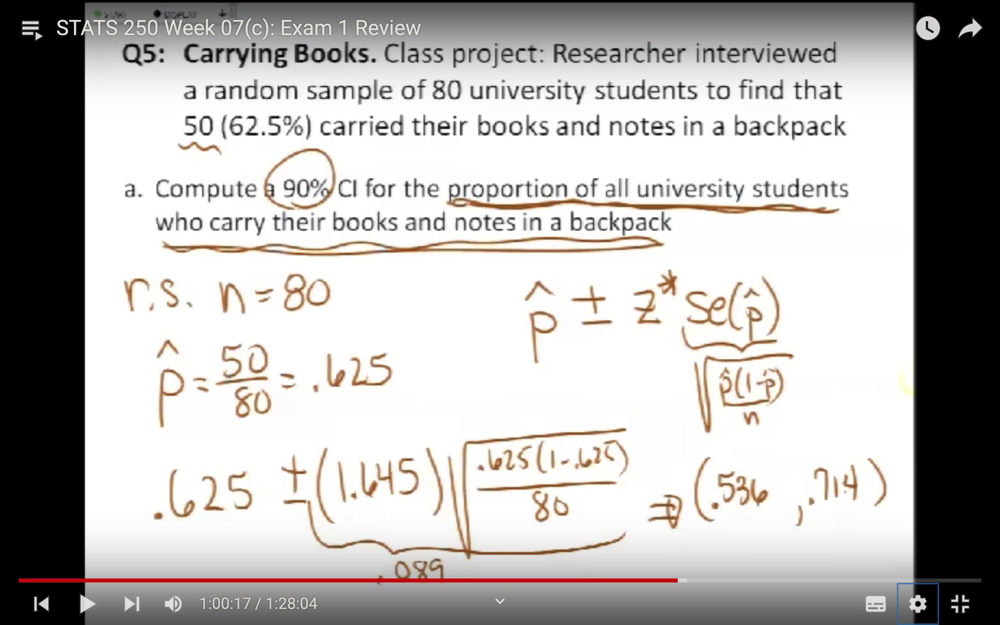

In [17]:
def ci_tester(z, p_hat, n):
    z_val = stats.norm.ppf((1+z)/2)
    print(z_val)
    #sep = math.sqrt(((p_hat)*(1-p_hat))/(n))
    sep = math.sqrt (  ((p_hat)*(1-p_hat))/(n)   )
    print(sep)
    ans1 = p_hat + (z_val*sep)
    ans2 = p_hat - (z_val*sep)
    print(ans2, ans1)

    
ci_tester(0.90, 0.625, 80)
    

1.6448536269514722
0.05412658773652741
0.5359696858470658 0.7140303141529342


In [18]:
#Use this to get the confidence interval of a population proportion with a Z
def ci_pop_prop_z(z, p_hat, n):
    z_val = stats.norm.ppf((1+z)/2)
    print(z_val)
    #sep = math.sqrt(((p_hat)*(1-p_hat))/(n))
    sep = math.sqrt (  ((p_hat)*(1-p_hat))/(n)   )
    print(sep)
    ans1 = p_hat + (z_val*sep)
    ans2 = p_hat - (z_val*sep)
    print(ans2, ans1)
    return ans2, ans1

    
ci_pop_prop_z(0.90, 0.625, 80)
    

1.6448536269514722
0.05412658773652741
0.5359696858470658 0.7140303141529342


(0.5359696858470658, 0.7140303141529342)

In [135]:
ci_pop_prop_z(0.90, 0.53, 861 )

1.6448536269514722
0.017009254842301588
0.5020222654808983 0.5579777345191017


(0.5020222654808983, 0.5579777345191017)

In [129]:
#Use this to get the conservative confidence interval of a population proportion with a Z
def ci_pop_prop_z_conservative(z, p_hat, n):
    z_val = stats.norm.ppf((1+z)/2)
    print(z_val)
    #sep = math.sqrt(((p_hat)*(1-p_hat))/(n))
    cons_sep = (z_val)/(2*math.sqrt(n))
    print(cons_sep)
    ans1 = p_hat + (z_val*cons_sep)
    ans2 = p_hat - (z_val*cons_sep)
    print(ans2, ans1)
    return ans2, ans1

    
ci_pop_prop_z_conservative(0.90, 0.625, 80)
    

1.6448536269514722
0.0919501130725143
0.47375552301407686 0.7762444769859231


(0.47375552301407686, 0.7762444769859231)

In [130]:
ci_pop_prop_z_conservative(0.95, 0.11357, 1400)

1.959963984540054
0.026191120430589927
0.06223634724129255 0.16490365275870744


(0.06223634724129255, 0.16490365275870744)

In [131]:
ci_pop_prop_z_conservative(0.95, 0.11357, 159)

1.959963984540054
0.0777176272944971
-0.038753750461121395 0.2658937504611214


(-0.038753750461121395, 0.2658937504611214)

In [42]:
#USe this to find the confidence interval for a sample mean, t value, sample s and sample size
def ci_pop_mean_t (mean, t_p, s, n):
    dof = n-1
    print(dof)
    sex = s/(math.sqrt(n))
    print(sex)
    #t_val = stats.t.ppf(t_p, dof)
    t_val = stats.t.ppf((1+t_p)/2, dof)
    #(1+z)/2)
    print(t_val)
    ans1 = mean + (t_val*sex)
    ans2 = mean - (t_val*sex)
    print(ans2, ans1)
    return ans2, ans1


ci_pop_mean_t(497.3, 0.95, 73.4, 15)

14
18.951798507441627
2.1447866879169273
456.6524348491553 537.9475651508448


(456.6524348491553, 537.9475651508448)

In [21]:
ci_pop_mean_t(3.62, 0.95, 3.06, 34)

33
0.524785670536077
2.0345152974493383
2.552315525412143 4.687684474587858


(2.552315525412143, 4.687684474587858)

In [44]:
ci_pop_mean_t(0.850, 0.99, 2.338, 40)

39
0.3696702584736835
2.707913183517646
-0.15103496647526338 1.8510349664752632


(-0.15103496647526338, 1.8510349664752632)

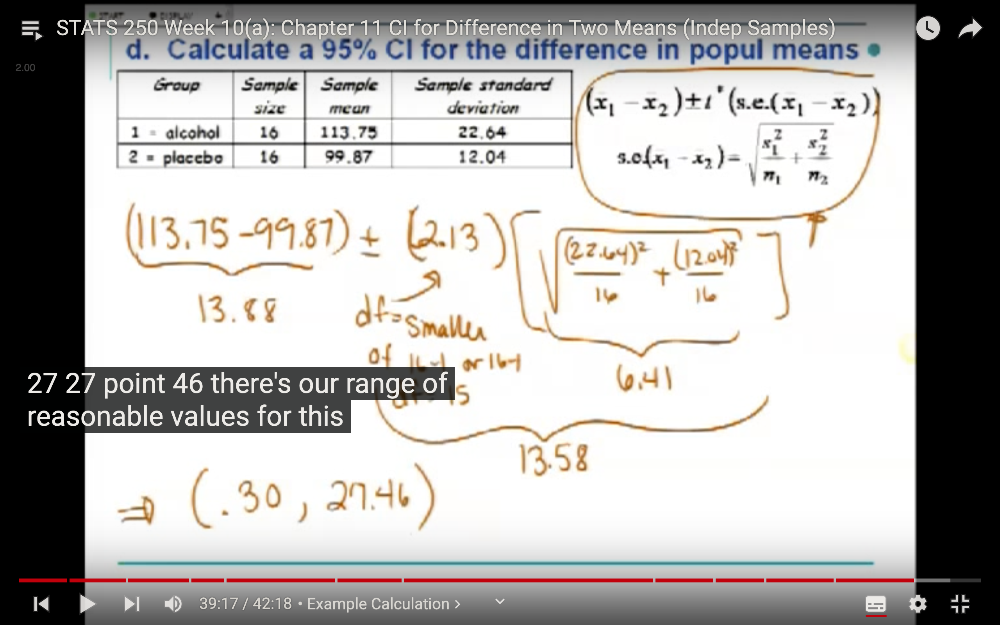

In [22]:
#USe this to find the confidence interval for the difference in 2 sample mean, t value, sample s and sample sizes
def ci_2_pop_mean_general(mean1, mean2, s1, s2, n1, n2, t_p):
    dof = min(n1-1, n2-1)
    mean_diff = mean1 - mean2
    t_val = stats.t.ppf((1+t_p)/2, dof)
    print(t_val)
    sex1 = (s1**2)/n1
    sex2 = (s2**2)/n2
    sext = math.sqrt(sex1 + sex2)
    ans1 = mean_diff + t_val*sext
    ans2 = mean_diff - t_val*sext
    print(ans2, ans1)
    return ans2, ans1


ci_2_pop_mean_general(113.75, 99.87, 22.64, 12.04, 16, 16, 0.95) 

2.131449545559323
0.21614489755607735 27.543855102443914


(0.21614489755607735, 27.543855102443914)

In [23]:
#USe this to find the confidence interval for the difference in 2 sample mean, t value, sample s and sample sizes
def ci_2_pop_mean_pooled(mean1, mean2, s1, s2, n1, n2, t_p):
    dof = (n1+n2)-2
    mean_diff = mean1 - mean2
    t_val = stats.t.ppf((1+t_p)/2, dof)
    print(t_val)
    #The N part on the right
    right_n = math.sqrt((1/n1) + (1/n2))
    #The Sp part
    sp_numereator_left = ((n1-1)*(s1**2))
    sp_numberator_right = ((n2-1)*(s2**2))
    sp = math.sqrt((sp_numereator_left + sp_numberator_right)/(dof))
    pooled_sp = sp*right_n
    ans1 = mean_diff + t_val*pooled_sp
    ans2 = mean_diff - t_val*pooled_sp
    print(ans2, ans1)
    return ans2, ans1

    
    
ci_2_pop_mean_pooled(113.75, 99.87, 22.64, 12.04, 16, 16, 0.95)
    

2.0422724563012373
0.7878229035491486 26.972177096450842


(0.7878229035491486, 26.972177096450842)

In [139]:
ci_2_pop_mean_pooled(0.451, 0.581, 0.139, 0.167, 87, 94, 0.90)

1.653410800122353
-0.1679257530759536 -0.09207424692404632


(-0.1679257530759536, -0.09207424692404632)

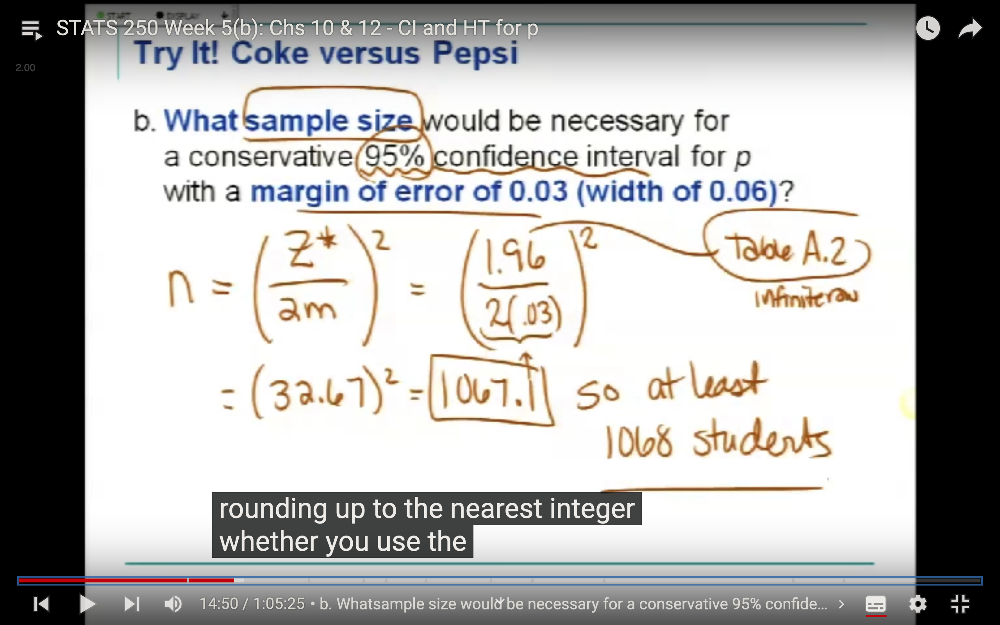

In [24]:
#Use this to get the sample size needed for a conservative confidence interval of a population proportion with a Z
def pop_prof_z_sample_size(z, margin):
    z_val = stats.norm.ppf((1+z)/2)
    print(z_val)
    n = (z_val/(2*margin))**2
    print(n)
    return n

pop_prof_z_sample_size(0.95, 0.03)

1.959963984540054
1067.0718946372572


1067.0718946372572

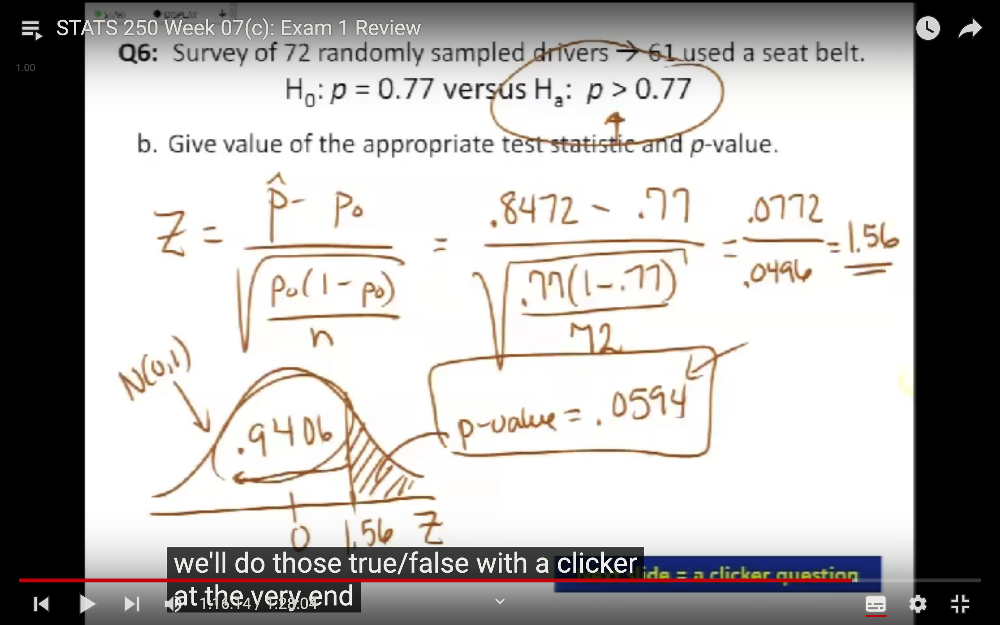

In [25]:
def pop_prop_large_z_test_v1(p_hat, po, n):
    q = 1 - po
    numerator = p_hat-po
    denom = (po*q)/n
    z = numerator/(math.sqrt(denom))
    p = stats.norm.cdf(z)
    print("Z is " +str(z))
    print("p is " +str(p))
    return z, p
                   
z, p = pop_prop_large_z_test_v1(0.8472, 0.77, 72)
print(1-p) #It's a right tail test

Z is 1.5565901142362422
p is 0.940216083802988
0.059783916197011955


In [136]:
z, p = pop_prop_large_z_test_v1(0.53, 0.81, 861)

Z is -20.943067725860526
p is 1.0851278770386287e-97


In [27]:
z, p = z_score_finder_r(75, 5, 70)

print(z, p)

Z is -1.0
p is 0.15865525393145707
-1.0 0.15865525393145707


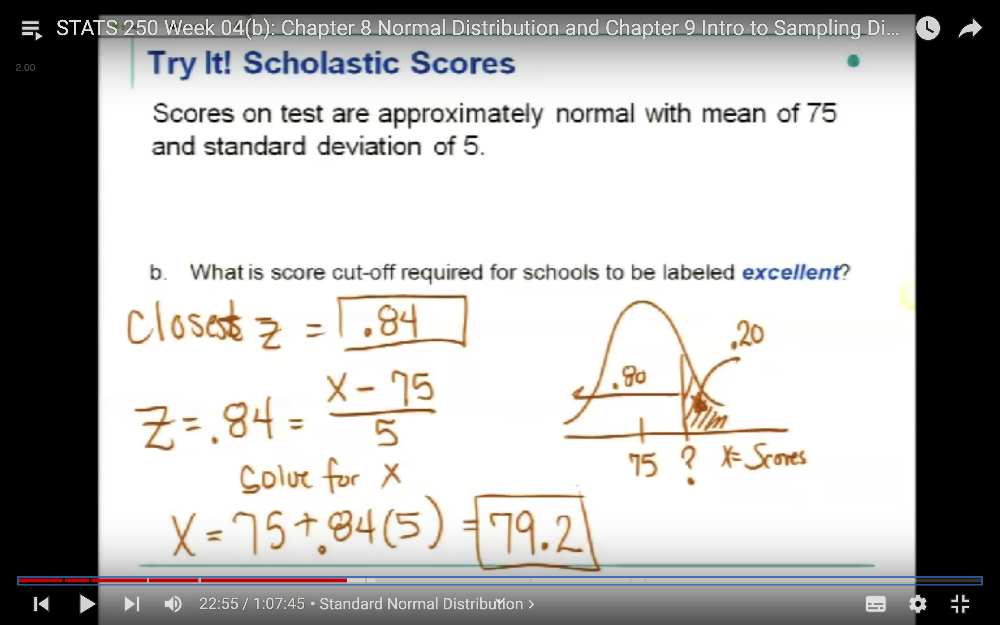

In [28]:
def reverse_z_score_finder_r(mean, std, z_val):
    target = (z_val*std)+mean
    print("Target is " +str(target))
    #print("p is " +str(p))
    return target

#z_val = stats.norm.ppf(0.84)
#z_val = stats.norm.ppf((1+0.8)/2)
z_val = stats.norm.ppf(0.8)
target = reverse_z_score_finder_r(75, 5, z_val)

print(target)

now()    


Target is 79.20810616786457
79.20810616786457
 
 Current Time = 13:15:39


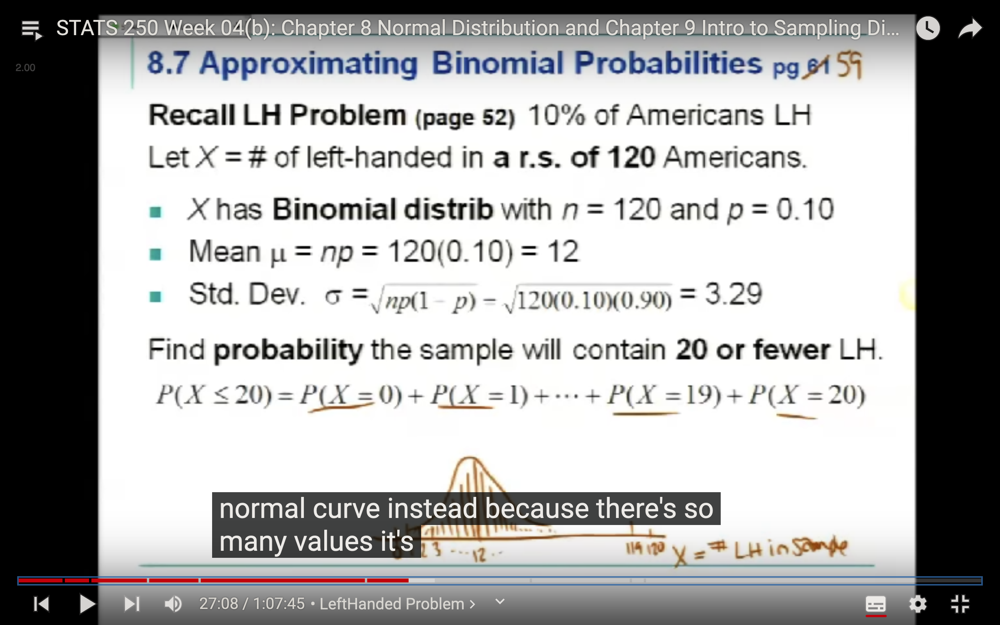

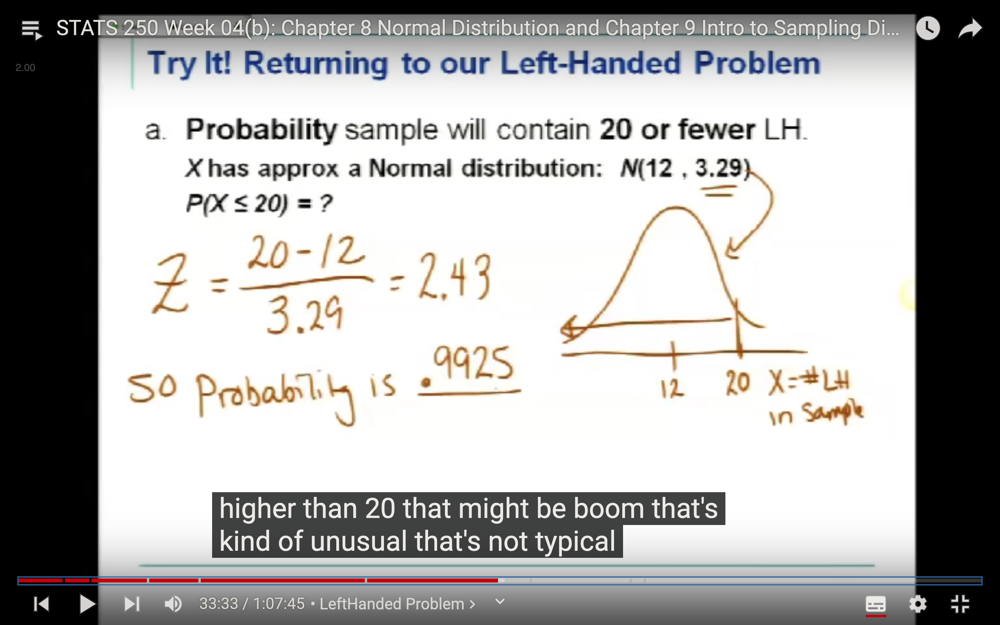

In [29]:
#using my binom calulator
binom_calc(120, 20, 0.10)

0.9920588077516064


0.9920588077516064

In [30]:
#using my Z score finder function and assuming it has a normal distribution:

z, p = z_score_finder_r(12, 3.29, 20)

print(z, p)

Z is 2.43161094224924
p is 0.9924840779817576
2.43161094224924 0.9924840779817576


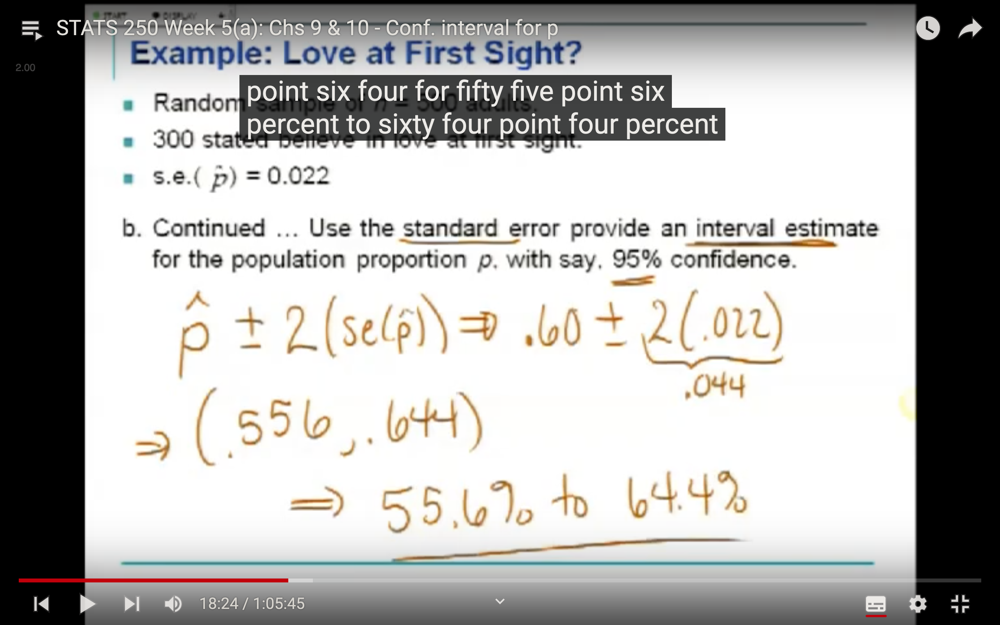

In [31]:
ci_tester(0.95, 0.6, 500)

1.959963984540054
0.021908902300206645
0.5570593405507882 0.6429406594492117


In [32]:
ci_tester(0.95, 0.54, 501)

1.959963984540054
0.022266755112353775
0.4963579619272135 0.5836420380727866


In [33]:
z, p = pop_prop_large_z_test_v1(0.12, 0.10, 150)
print(1-p) #It's a right tail test

Z is 0.8164965809277256
p is 0.7928919108787373
0.20710808912126266


In [34]:
z, p = pop_prop_large_z_test_v1(0.44, 0.48, 500)
print(p*2) #It's a 2 tail test

Z is -1.7902871850985813
p is 0.036703877661771654
0.07340775532354331


In [35]:
z, p = pop_prop_large_z_test_v1(0.9, 0.5, 10)
print(1-p) #It's a right tail test

Z is 2.5298221281347035
p is 0.9942939818069991
0.005706018193000872


In [36]:
ans1 = binom_calc(10, 8, 0.5)
#n, r, p
print(1-ans1)
now()

0.9892578125
0.0107421875
 
 Current Time = 13:15:39


In [37]:
    
z, p = z_score_finder_r(18.6, 5.9, 21)

print("p-1= " + str(1-p))

now()    

Z is 0.4067796610169489
p is 0.6579150868754927
p-1= 0.3420849131245073
 
 Current Time = 13:15:39


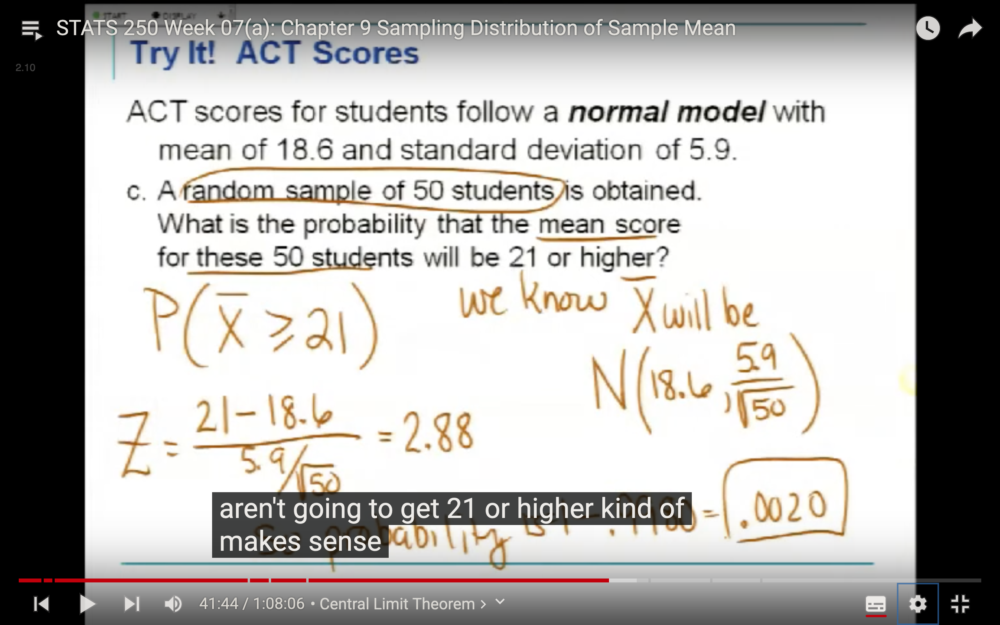

In [38]:
    
z, p = z_score_finder_r(18.6, (5.9/math.sqrt(50)), 21)

print("p-1= " + str(1-p))

now()    

Z is 2.8763665675384966
p is 0.9979885888173199
p-1= 0.0020114111826801118
 
 Current Time = 13:15:39


In [39]:
pop_prof_z_sample_size(0.95, 0.05)

1.959963984540054
384.14588206941244


384.14588206941244

In [40]:
t, p = t_score_finder_r(15, 0.5, 14, 100)

T is 2.8763665675384966
p is 7.532224297300853e-37


In [54]:
def goodness_of_fit(list1):
    total = sum(list1)
    print(total)
    length = len(list1)
    print(length)
    exp = total/length
    print(exp)
    list2 = [exp]*length
    print(list2)
    chi, p = chisquare(list1, f_exp=list2)
    print(chi)
    print(p)
    return chi, p
    
list1 = [26, 20, 28, 26]
    
goodness_of_fit(list1)

100
4
25.0
[25.0, 25.0, 25.0, 25.0]
1.44
0.6961858724031276


In [119]:
list1 = [315, 101, 108, 32]
list2 = [315*(9/16), 101*(3/16), 108*(3/16), 32*(1/16) ]

chi, p = chisquare(list1, f_exp=list2)
print(chi)
print(p)

<class 'TypeError'>: int() argument must be a string, a bytes-like object or a real number, not 'list'

In [58]:
data1 = [25, 30, 20]
data2= [26, 23, 26]

test_statistic, p_value = stats.bartlett(data1, data2)
  
print(test_statistic, p_value)

1.5370024731107308 0.21506453305831555


In [59]:
data1 = [54, 16]
data2= [42, 32]
data3 = [134, 142]

test_statistic, p_value = stats.bartlett(data1, data2, data3)
  
print(test_statistic, p_value)

1.9475840038236032 0.377648276526736


In [60]:
data1 = [54, 42, 134]
data2= [16, 32, 142]


test_statistic, p_value = stats.bartlett(data1, data2)
  
print(test_statistic, p_value)

0.1571170332564634 0.6918247842749117


In [64]:
stat, p = levene(data1, data2)
print(stat, p)

0.07144622991347341 0.8024583139757067


In [124]:
def test_of_homo(list1):
    a = np.array(list1, dtype=float)
    print(a.dtype)
    #n = a.size
    num_rows = a.shape[0]
    num_cols = a.shape[1]
    dof = (num_cols-1)*(num_rows-1)
    column_totals = np.sum(a, axis=0)
    row_totals = np.sum(a, axis=1)
    n = sum(row_totals)
    b = np.array(list1, dtype=float)
    c = 0
    for x in range(num_rows):
      for y in range(num_cols):
        print("X is " + str(x))
        print("Y is " + str(y))
        print("a[x][y] is " + str(a[x][y]))
        print("row_totals[x] is " + str(row_totals[x]))
        print("column_total[y] is " + str(column_totals[y]))
        b[x][y] = (float(row_totals[x])*float(column_totals[y]))/float(n)
        print("b[x][y] is " + str(b[x][y]))
        numerator = ((a[x][y]) - b[x][y])**2
        chi =  float(numerator)/float(b[x][y])
        c = float(c)+ float(chi)
    print(b)
    print(c)
    print(stats.chi2.cdf(c, df=dof))
    print(1-(stats.chi2.cdf(c, df=dof)))
    
    
test_of_homo(lista)

float64
X is 0
Y is 0
a[x][y] is 54.0
row_totals[x] is 230.0
column_total[y] is 70.0
b[x][y] is 38.333333333333336
X is 0
Y is 1
a[x][y] is 42.0
row_totals[x] is 230.0
column_total[y] is 74.0
b[x][y] is 40.523809523809526
X is 0
Y is 2
a[x][y] is 134.0
row_totals[x] is 230.0
column_total[y] is 276.0
b[x][y] is 151.14285714285714
X is 1
Y is 0
a[x][y] is 16.0
row_totals[x] is 190.0
column_total[y] is 70.0
b[x][y] is 31.666666666666668
X is 1
Y is 1
a[x][y] is 32.0
row_totals[x] is 190.0
column_total[y] is 74.0
b[x][y] is 33.476190476190474
X is 1
Y is 2
a[x][y] is 142.0
row_totals[x] is 190.0
column_total[y] is 276.0
b[x][y] is 124.85714285714286
[[ 38.33333333  40.52380952 151.14285714]
 [ 31.66666667  33.47619048 124.85714286]]
18.570724978286414
0.9999072277032502
9.277229674975462e-05


In [114]:
def test_of_homo(list1):
    a = np.array(list1)
    #n = a.size
    num_rows = a.shape[0]
    num_cols = a.shape[1]
    dof = (num_cols-1)*(num_rows-1)
    column_totals = np.sum(a, axis=0)
    l_column_totals = column_totals.tolist()
    row_totals = np.sum(a, axis=1)
    l_row_totals = row_totals.tolist()
    n = sum(row_totals)
    b = np.array(list1)
    c = 0
    for x in range(num_rows):
      for y in range(num_cols):
        print("X is " + str(x))
        print("Y is " + str(y))
        print("a[x][y] is " + str(a[x][y]))
        print("row_totals[x] is " + str(row_totals[x]))
        print("column_total[y] is " + str(column_totals[y]))
        temp_x = l_row_totals[x]
        temp_x = decimal.Decimal(temp_x)
        temp_y = l_column_totals[x]
        temp_y = decimal.Decimal(temp_y)
        #b[x][y] = decimal.Decimal((row_totals[x])*(column_totals[y]))/decimal.Decimal(n)
        b[x][y] = (temp_x*temp_y)/decimal.Decimal(n)
        print("b[x][y] is " + str(b[x][y]))
        numerator = ((a[x][y]) - b[x][y])**2
        chi =  decimal.Decimal(numerator)/decimal.Decimal(b[x][y])
        c = decimal.Decimal(c)+ decimal.Decimal(chi)
    print(b)
    print(c)
    print(stats.chi2.cdf(c, df=dof))
    print(1-(stats.chi2.cdf(c, df=dof)))
    
    
test_of_homo(lista)

X is 0
Y is 0
a[x][y] is 54
row_totals[x] is 230
column_total[y] is 70


<class 'TypeError'>: conversion from numpy.int32 to Decimal is not supported

In [73]:
lista = [(54, 42, 134), (16,32, 142)]

lista[1][1]

32

In [74]:
len(lista)

2

In [75]:
len(lista[0])

3

In [78]:
res = [sum(x) for x in zip(*lista)]
print(res)

[70, 74, 276]


In [85]:
a = np.array(lista)
resa = np.sum(a, axis=0)
resb = np.sum(a, axis=1)

print(resa, resb)
a[0][0]
print(resa[0], resb[0])

[ 70  74 276] [230 190]
70 230


In [86]:
a.shape

(2, 3)

In [87]:
b = a.shape

In [88]:
b[0]

2

In [125]:
listc = [(21, 36, 30), (48, 26, 19)]

test_of_homo(listc)

float64
X is 0
Y is 0
a[x][y] is 21.0
row_totals[x] is 87.0
column_total[y] is 69.0
b[x][y] is 33.35
X is 0
Y is 1
a[x][y] is 36.0
row_totals[x] is 87.0
column_total[y] is 62.0
b[x][y] is 29.966666666666665
X is 0
Y is 2
a[x][y] is 30.0
row_totals[x] is 87.0
column_total[y] is 49.0
b[x][y] is 23.683333333333334
X is 1
Y is 0
a[x][y] is 48.0
row_totals[x] is 93.0
column_total[y] is 69.0
b[x][y] is 35.65
X is 1
Y is 1
a[x][y] is 26.0
row_totals[x] is 93.0
column_total[y] is 62.0
b[x][y] is 32.03333333333333
X is 1
Y is 2
a[x][y] is 19.0
row_totals[x] is 93.0
column_total[y] is 49.0
b[x][y] is 25.316666666666666
[[33.35       29.96666667 23.68333333]
 [35.65       32.03333333 25.31666667]]
14.463579015563466
0.9992767745131841
0.0007232254868159149


In [126]:
z, p = z_score_finder_r(7.5, 1.3, 5)

print("p-1= " + str(1-p))

now()    

Z is -1.923076923076923
p is 0.027235195013738698
p-1= 0.9727648049862613
 
 Current Time = 19:21:05
